<a href="https://colab.research.google.com/github/gracel0721/CS-301-Project/blob/main/docs/CS_301_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#read through paper
#look through kaggle submissions
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

from glob import glob

import librosa
import librosa.display
import IPython.display as ipd
import keras

from itertools import cycle

sns.set_theme(style="white", palette=None)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()["color"]
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()["color"])


from tqdm import tqdm
import scipy as sp
import soundfile as sf
import random
import os, shutil


from google.colab import files

#uncomment the line below if you want to upload your json directly from your local files
#uploaded = files.upload()

Saving kaggle.json to kaggle.json


In [2]:
!mkdir /root/.kaggle/
!mv ./kaggle.json /root/.kaggle/kaggle.json

In [3]:
!pip install kaggle
!kaggle -v

Kaggle API 1.5.12


In [4]:
%ls /root/.kaggle/

kaggle.json


In [5]:
!chmod 600 /root/.kaggle/kaggle.json

In [6]:
!kaggle competitions download -c kaggle-pog-series-s01e02 -p /content/kaggle/MusicClassification

100% 9.04G/9.05G [04:17<00:00, 58.7MB/s]
100% 9.05G/9.05G [04:17<00:00, 37.7MB/s]


In [7]:
!unzip -q /content/kaggle/MusicClassification/kaggle-pog-series-s01e02.zip -d /content/kaggle/MusicClassification

In [8]:
for dirname, _, filenames in os.walk('../content/kaggle/MusicClassification/train'):
    paths = [os.path.join(dirname, filename) for filename in filenames]
    id = [filename.split('.')[0] for filename in filenames]
    
df_train = pd.DataFrame({'song_id':id})
df_train.song_id = df_train["song_id"].astype(int)

In [9]:
f1 = '/content/kaggle/MusicClassification/train/000000.ogg'

train_csv = pd.read_csv('/content/kaggle/MusicClassification/train.csv')
test_csv = pd.read_csv('/content/kaggle/MusicClassification/test.csv')
audio_dataset = '/content/kaggle/MusicClassification/train'
test_dataset = '/content/kaggle/MusicClassification/test'
genre = pd.read_csv('/content/kaggle/MusicClassification/genres.csv')
ss = pd.read_csv('/content/kaggle/MusicClassification/sample_submission.csv')
ss

,song_id,genre_id
0,7072,0
1,10207,0
2,20008,0
3,10924,0
4,21896,0
...,...,...
5073,6427,0
5074,16903,0
5075,1731,0
5076,12871,0


In [10]:
# Missing files due to corruption during creation of dataset
print("The number of files as per train folder :", len(os.listdir(audio_dataset)))
print("The number of files as per train csv :", train_csv.shape[0])
train_csv.head()

The number of files as per train folder : 19909
The number of files as per train csv : 19922


,song_id,filename,filepath,genre_id,genre
0,10150,010150.ogg,train/010150.ogg,7,Instrumental
1,7358,007358.ogg,train/007358.ogg,2,Punk
2,20573,020573.ogg,train/020573.ogg,5,Folk
3,11170,011170.ogg,train/011170.ogg,12,Old-Time / Historic
4,16662,016662.ogg,train/016662.ogg,1,Rock


In [11]:
#files that are missing in training folder that are found in f
df= df_train.merge(train_csv, on = 'song_id')
df.head()

,song_id,filename,filepath,genre_id,genre
0,20629,020629.ogg,train/020629.ogg,11,Classical
1,22310,022310.ogg,train/022310.ogg,3,Experimental
2,12248,012248.ogg,train/012248.ogg,0,Electronic
3,617,000617.ogg,train/000617.ogg,10,Ambient Electronic
4,19196,019196.ogg,train/019196.ogg,6,Chiptune / Glitch


In [12]:
#all the genres in train
train_csv.genre.unique()

array(['Instrumental', 'Punk', 'Folk', 'Old-Time / Historic', 'Rock',
       'International', 'Chiptune / Glitch', 'Experimental', 'Pop',
       'Electronic', 'Hip-Hop', 'Jazz', 'Classical', 'Ambient Electronic',
       'Blues', 'Easy Listening', 'Soul-RnB', 'Country', 'Spoken'],
      dtype=object)

In [13]:
#We will split the data to folders, This cell will be split the genres to different folders for further simplification
genre["genre_folder"] = genre["genre"].str.split("/", expand = True)[0].str.strip()
genre

,genre,genre_id,genre_folder
0,Electronic,0,Electronic
1,Rock,1,Rock
2,Punk,2,Punk
3,Experimental,3,Experimental
4,Hip-Hop,4,Hip-Hop
5,Folk,5,Folk
6,Chiptune / Glitch,6,Chiptune
7,Instrumental,7,Instrumental
8,Pop,8,Pop
9,International,9,International


In [14]:
#displaying songs from each genre
Dir = '/content/kaggle/MusicClassification/'

for gen in df.genre.unique():
    print('Genre of the song is:', gen)
    ipd.display(ipd.Audio(Dir + df[df['genre'] == gen].sample(1, random_state = 33)['filepath'].values[0]))

Genre of the song is: Classical


Genre of the song is: Experimental
Genre of the song is: Electronic


Genre of the song is: Ambient Electronic


Genre of the song is: Chiptune / Glitch


Genre of the song is: Rock


Genre of the song is: Instrumental


Genre of the song is: Hip-Hop


Genre of the song is: Punk


Genre of the song is: Country


Genre of the song is: Pop


Genre of the song is: Folk


Genre of the song is: Jazz


Genre of the song is: Old-Time / Historic


Genre of the song is: International


Genre of the song is: Easy Listening


Genre of the song is: Spoken


Genre of the song is: Soul-RnB


Genre of the song is: Blues


In [15]:
audio_data, sample_rate = librosa.load(Dir + train_csv.filepath[0])
audio_test_data, test_sr= librosa.load(Dir +test_csv.filepath[0])
print('Genre of the song is:', train_csv.genre[4], '\n')

print('Data:', audio_data, '\n')
print('Len of Data:', audio_data.shape, '\n')
print('Sample Rate (KHz):', sample_rate, '\n')

# Audio Length
print(f'Check Len of Audio: {np.shape(audio_data)[0]/sample_rate} sec')

Genre of the song is: Rock 

Data: [ 1.8270198e-09 -2.1380105e-08 -6.6863961e-08 ...  2.1344839e-01
  2.0970175e-01  0.0000000e+00] 

Len of Data: (661560,) 

Sample Rate (KHz): 22050 

Check Len of Audio: 30.002721088435376 sec


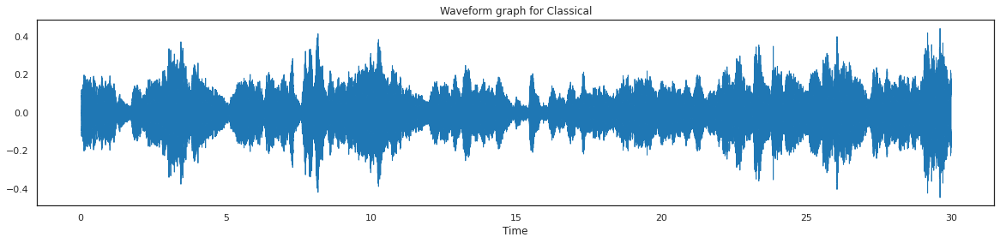

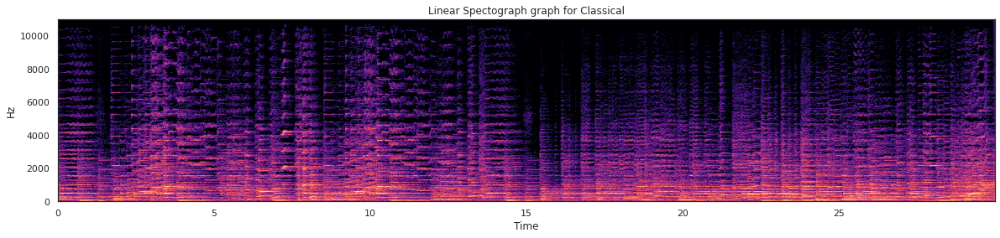

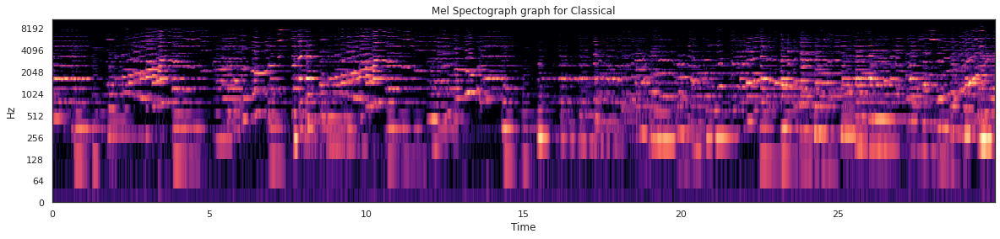

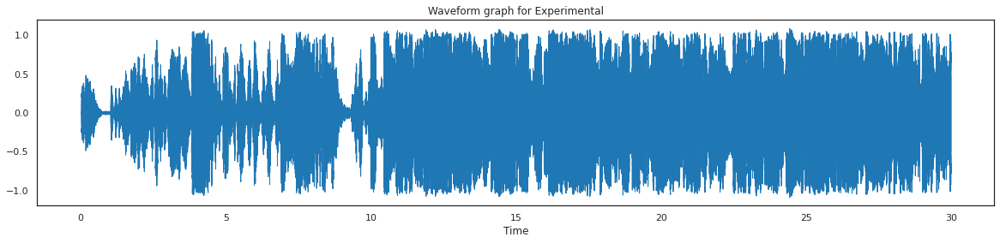

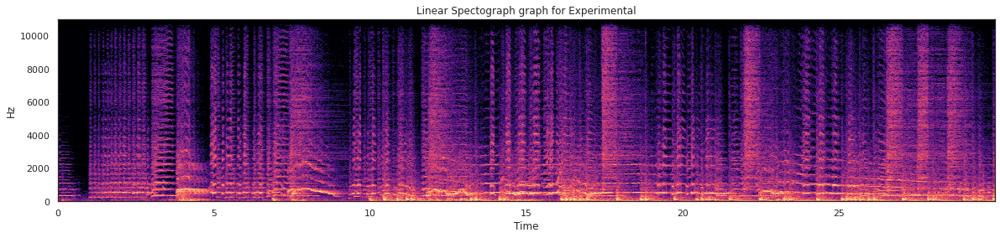

...

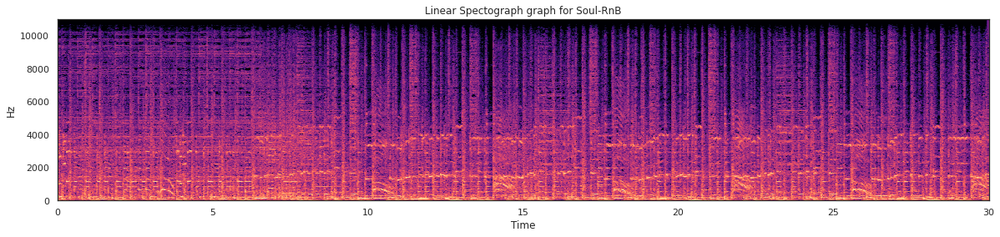

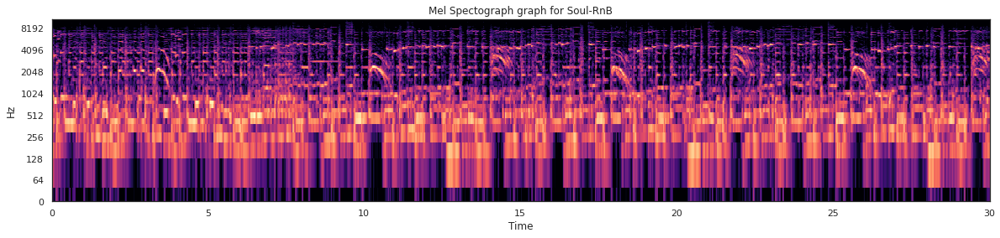

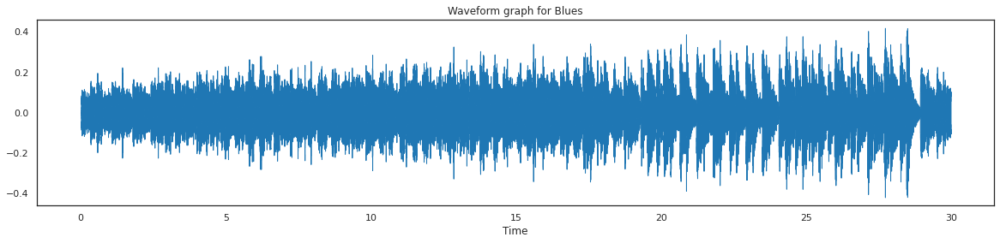

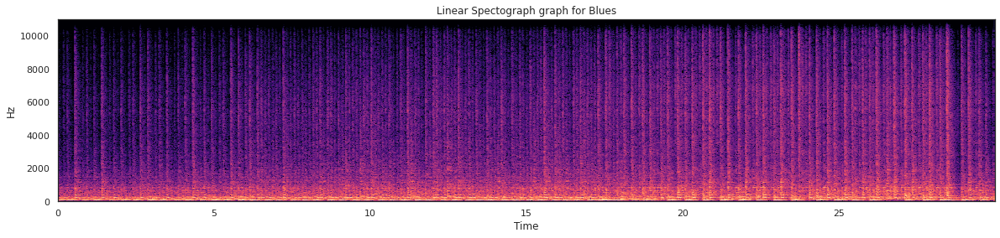

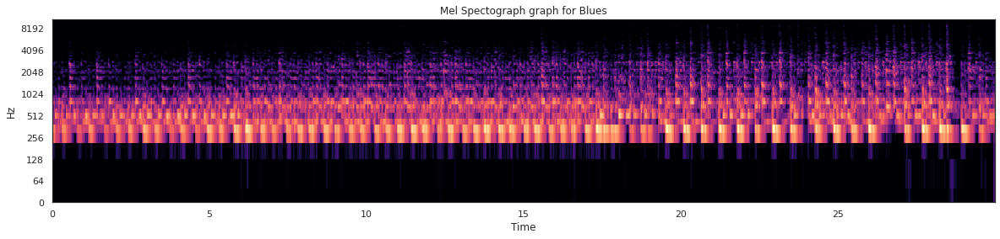

In [16]:
for gen in df.genre.unique():    
    y, sr = librosa.load(Dir + df[df['genre'] == gen].sample(1, random_state = 33)['filepath'].values[0])
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    plt.figure(figsize =(20, 4))
    librosa.display.waveshow(y = y, sr = sr) 
    plt.title(f"Waveform graph for {gen}")
    plt.show()
    plt.figure(figsize =(20, 4))
    librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr)
    plt.title(f"Linear Spectograph graph for {gen}")
    plt.show()
    S=librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
    S_db_mel = librosa.amplitude_to_db(S, ref=np.max)
    plt.subplots(figsize=(20, 4))
    librosa.display.specshow(S_db_mel,x_axis='time',y_axis='log',sr=sr)
    plt.title(f'Mel Spectograph graph for {gen}')
    plt.show()

In [17]:
#inorder to solve this we will check for beats per minute for each genre, and depending on that we will be able to classify each sound with its genre
bpm = []
for idx, row in tqdm(df.iterrows()):
    y,sr = librosa.load(Dir + row['filepath'])
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
    id = row['song_id']
    bpm.append([id, tempo, beats])

1272it [31:00,  1.46s/it]


KeyboardInterrupt: ignored

In [18]:
audio_files_train = sorted(glob('/content/kaggle/MusicClassification/train/*.ogg'))
audio_files_test = sorted(glob('/content/kaggle/MusicClassification/test/*.ogg'))

In [26]:
y_test, sr_test = librosa.load(audio_files_test[0])
y_train, sr_train = librosa.load(audio_files_train[0])
print(f'y: {y[:10]}')
print(f'shape y: {y.shape}')
print(f'sr: {sr}')

y: [0.02241742 0.0352436  0.02792463 0.02188762 0.01171296 0.01296763
 0.01467508 0.02031634 0.03145663 0.03870362]
shape y: (660984,)
sr: 22050


In [27]:
D = librosa.stft(y_train)
S_db = librosa.amplitude_to_db(np.abs(D),ref=np.max)
S_db.shape

(1025, 1293)

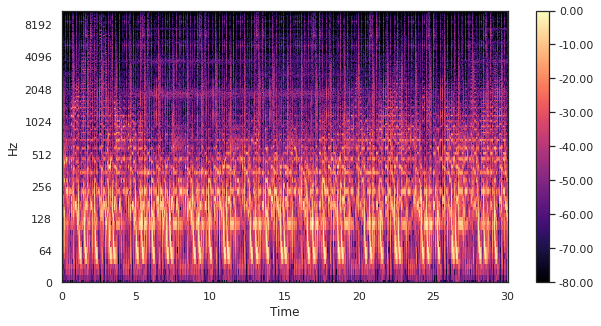

In [28]:
fig, ax = plt.subplots(figsize=(10,5))
img = librosa.display.specshow(S_db,
                               x_axis= 'time',
                               y_axis = 'log',
                               ax=ax)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()

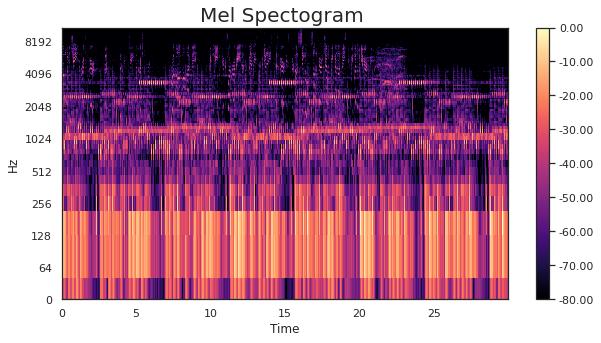

In [29]:
S=librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
S_db_mel = librosa.amplitude_to_db(S, ref=np.max)
fig, ax = plt.subplots(figsize=(10, 5))
img = librosa.display.specshow(S_db_mel,
                              x_axis='time',
                              y_axis='log',
                              ax=ax)
ax.set_title('Mel Spectogram ', fontsize=20)
fig.colorbar(img, ax=ax, format=f'%0.2f')
plt.show()

In [31]:
#mel cepstral freq coefficients

mfccs = librosa.feature.mfcc(y=y_train, sr=sr_train, n_mfcc=19)
mfccs_test= librosa.feature.mfcc(y=y_test, sr=sr_test, n_mfcc=40)

[Text(0.5, 1.0, 'MFCC')]

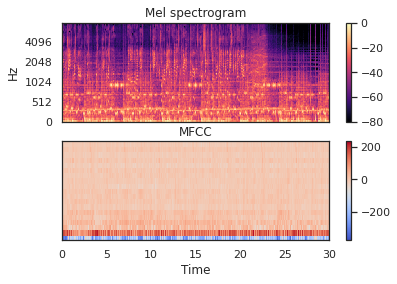

In [32]:
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.power_to_db(S, ref=np.max),
                               x_axis='time', y_axis='mel', fmax=8000,
                               ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].set(title='Mel spectrogram')
ax[0].label_outer()
img = librosa.display.specshow(mfccs, x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])
ax[1].set(title='MFCC')

In [33]:
from keras import layers
from keras import models

model = keras.Sequential(
    [
        layers.Dense(2, activation="relu", name="layer1"),
        layers.Dense(3, activation="relu", name="layer2"),
        layers.Dense(4, name="layer3"),
    ]
)



In [34]:
from tensorflow.keras import optimizers

model.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


In [42]:
##fit the model

In [43]:
#plot results +loss